In [58]:
from google.colab import drive
drive.mount('/gdrive')

Drive already mounted at /gdrive; to attempt to forcibly remount, call drive.mount("/gdrive", force_remount=True).


In [1]:
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torchvision.models.detection import FasterRCNN
import torchvision
import torch
from torch.utils.data import DataLoader
from torchvision import transforms

import matplotlib.pyplot as plt
import os, sys, cv2
import numpy as np
from PIL import Image
from pycocotools.coco import COCO
from google.colab.patches import cv2_imshow
torch.cuda.empty_cache()

In [ ]:
dir(torchvision.datasets)

In [6]:
class SubCocoDetection(torch.utils.data.Dataset):
    """`MS Coco Detection <http://mscoco.org/dataset/#detections-challenge2016>`_ Dataset.

    Args:
    root (string): Root directory where images are downloaded to.
    annFile (string): Path to json annotation file.
    transform (callable, optional): A function/transform that  takes in an PIL image and returns a transformed version. E.g, ``transforms.ToTensor``
    target_transform (callable, optional): A function/transform that takes in the target and transforms it.
    transforms (callable, optional): A function/transform that takes input sample and its target as entry and returns a transformed version.
    """

    def __init__(self, root, annFile, classes, transform=None, target_transform=None, transforms=None):
        # super(CocoDetection, self).__init__(root, transforms, transform, target_transform)
        self.root = root
        self.coco = COCO(annFile) # load entire coco annotation file
        self.transforms = transforms
        self.ids = sorted(self.coco.getImgIds(catIds=self.coco.getCatIds(catNms=classes))) # get list of image ids
        print("number of images in {} = {}".format(classes, len(self.ids)))

    def __getitem__(self, index):
        """
        Args:
            index (int): index

        Returns:
            img, target (tuple): target is the object returned by ``coco.loadAnns``.
        """
        coco = self.coco 
                
        img_id = self.ids[index] # get one image id according to the index
        ann_ids = coco.getAnnIds(imgIds=img_id) # load annotation ids related to that image id
        coco_annotation = coco.loadAnns(ann_ids) # load annotation labels in that image id from annotation ids
      
        path = coco.loadImgs(img_id)[0]['file_name'] # load image annotation related to that image id

        img = Image.open(os.path.join(self.root, path)).convert('RGB') # open the PIL image

        # number of objects in the image
        num_objs = len(coco_annotation)

        # Bounding boxes for objects
        # In coco format, bbox = [xmin, ymin, width, height]
        # In pytorch, the input should be [xmin, ymin, xmax, ymax]
        boxes = []
        areas = []
        labels = []
        for i in range(num_objs):
            xmin = coco_annotation[i]['bbox'][0]
            ymin = coco_annotation[i]['bbox'][1]
            xmax = xmin + coco_annotation[i]['bbox'][2]
            ymax = ymin + coco_annotation[i]['bbox'][3]
            boxes.append([xmin, ymin, xmax, ymax])

            labels.append(coco_annotation[i]['category_id'])
            areas.append(coco_annotation[i]['area'])

        boxes = torch.as_tensor(boxes, dtype=torch.float32)
        labels = torch.as_tensor(labels, dtype=torch.int64)
        areas = torch.as_tensor(areas, dtype=torch.float32)
        img_id = torch.tensor([img_id])    
        iscrowd = torch.zeros((num_objs,), dtype=torch.int64)

        # Annotation is in dictionary format
        target = {}
        target["boxes"] = boxes
        target["labels"] = labels
        target["image_id"] = img_id
        target["area"] = areas
        target["iscrowd"] = iscrowd

        # preprocess image if wanted
        if self.transforms is not None:
            img = self.transforms(img)

        return img, target

    def __len__(self):
        return len(self.ids)


def collate_fn(batch):
    return tuple(zip(*batch))


def get_model_faster_rcnn(is_finetune, num_classes=None):
    # load a model pre-trained on COCO
    model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True)

    if is_finetune is True:
        # get number of input features for the classifier
        in_features = model.roi_heads.box_predictor.cls_scores.in_features

        # replace the classifier with a new one that has num_classes
        model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)

    return model


def create_fgsm_example(image, epsilon, data_grad):
    # collect the element-wise sign of the data gradient
    sign_data_grad = data_grad.sign()

    # create the perturbed image by
    perturbed_image = image + epsilon * sign_data_grad

    # Add clipping to maintain [0,1] range
    perturbed_image = torch.clamp(perturbed_image, 0, 1)
    print('adv example generated!')

    return perturbed_image

    

def find_correct_detection(preds, targets):
    return preds



def test(root, model, device, data_loader, epsilon, COCO_INSTANCE_CATEGORY_NAMES):
    # Accuracy counter
    correct = 0
    adv_examples = []

    for imgs, targets in data_loader:

        # track gradient of this tensor
        imgs[0].requires_grad = True
        
        # move imgs and targets into GPU
        imgs = list(img.to(device) for img in imgs)
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]
        
        # Forward pass the data through the model
        model.train()
        loss_dict = model(imgs, targets)
        
        losses = sum(loss for loss in loss_dict.values())

        model.zero_grad()
        imgs[0].retain_grad()

        # calculate loss value that you want to maximize
        # loss_classifier, loss_box_reg', loss_objectness, loss_rpn_box_reg
        # losses.backward(), loss_dict['loss_classifier'].backward()
        losses.backward()
        data_grad = imgs[0].grad.data

        # Call FGSM Attack
        perturbed_img = create_fgsm_example(imgs[0], epsilon, data_grad)

        # Re-classify the perturbed image
        model.eval()
        pred = model([perturbed_img])
        image_id = str(targets[0]['image_id'].item())
        print('processing image {}'.format(image_id))
        file_name = '0'*(12-len(image_id)) + image_id

        print(targets[0]['labels'])

        object_detection_api('{}/{}.jpg'.format(root, file_name), pred, COCO_INSTANCE_CATEGORY_NAMES, threshold=0.7, rect_th=1, text_size=1, text_th=1)
        
        adv_examples.append(pred)

    return adv_examples


# In my case, just added ToTensor
def get_transform():
    custom_transforms = []
    custom_transforms.append(transforms.ToTensor())
    return transforms.Compose(custom_transforms)


def get_prediction(pred, threshold, COCO_INSTANCE_CATEGORY_NAMES):
    
    pred_class = [COCO_INSTANCE_CATEGORY_NAMES[i] for i in list(pred[0]['labels'].cpu().numpy())]
    
    # Get the Prediction Score
    pred_boxes = [[(i[0], i[1]), (i[2], i[3])] for i in list(pred[0]['boxes'].detach().cpu().numpy())] # Bounding boxes

    pred_score = list(pred[0]['scores'].detach().cpu().numpy())

    pred_t = [pred_score.index(x) for x in pred_score if x > threshold][-1] # Get list of index with score greater than threshold.

    pred_boxes = pred_boxes[:pred_t+1]

    pred_class = pred_class[:pred_t+1]

    return pred_boxes, pred_class


def object_detection_api(img_path, pred, COCO_INSTANCE_CATEGORY_NAMES, threshold, rect_th, text_size, text_th):

    boxes, pred_cls = get_prediction(pred, threshold, COCO_INSTANCE_CATEGORY_NAMES) # Get predictions
    print(boxes)
    print(pred_cls)

    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    for i in range(len(boxes)):
        cv2.rectangle(img, boxes[i][0], boxes[i][1], color=(255, 0, 0), thickness=rect_th)      
        cv2.putText(img, pred_cls[i], boxes[i][0], cv2.FONT_HERSHEY_SIMPLEX, text_size, (255, 0, 0), thickness=text_th) # Write the prediction class

    plt.figure(figsize=(20,30))
    plt.imshow(img)
    plt.show()


def plot_performance_degrade(epsilons, accuracies):
    plt.figure(figsize=(20,30))
    plt.plot(epsilons, accuracies, "*-")
    plt.yticks(np.arange(0, 1.1, step=0.1))
    plt.xticks(np.arange(0, .35, step=0.05))
    plt.title("Accuracy vs Epsilon")
    plt.xlabel("Epsilon")
    plt.ylabel("Accuracy")
    plt.show()

loading annotations into memory...
Done (t=0.80s)
creating index...
index created!
number of images in ['traffic light'] = 191
adv example generated!
processing image 248284
tensor([28,  1, 10, 10, 31,  1])
[[(279.8029, 155.95323), (385.45947, 413.3121)], [(177.59834, 31.5418), (200.40729, 68.342285)], [(245.57, 189.07806), (257.99402, 223.6474)], [(365.7534, 104.967674), (426.02838, 410.61255)], [(254.84343, 251.50821), (310.69748, 317.47354)], [(284.90402, 82.85053), (423.6747, 183.95306)]]
['person', 'traffic light', 'person', 'person', 'handbag', 'umbrella']


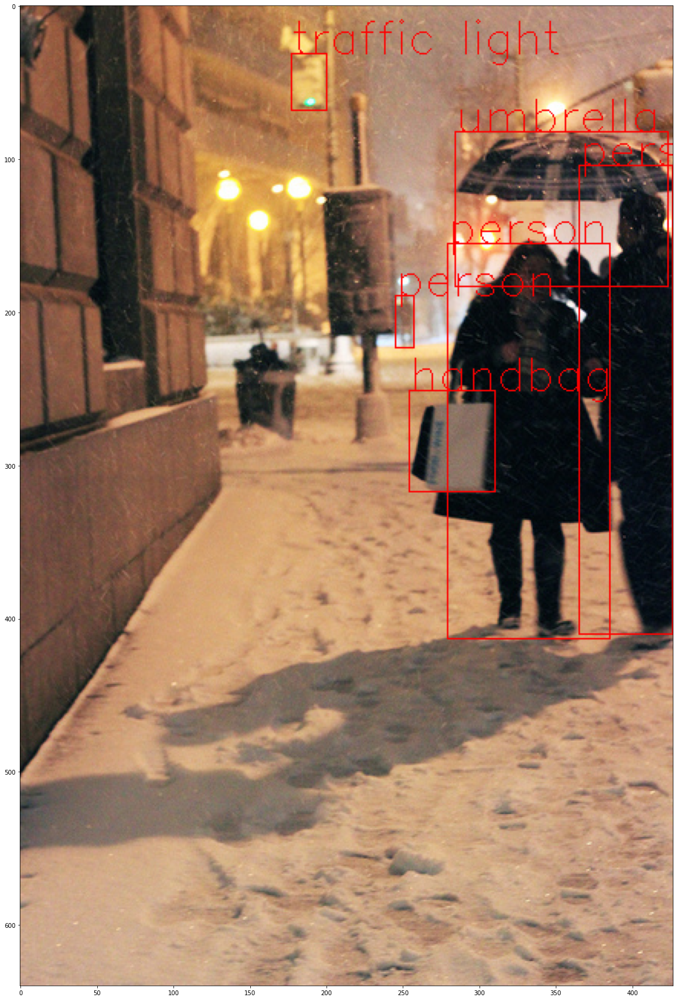

adv example generated!
processing image 274272
tensor([ 3,  3,  6,  1, 10, 10,  1,  1,  1])
[[(0.0, 391.3995), (83.41451, 475.3045)], [(40.07685, 387.79187), (217.53671, 479.7809)], [(190.28773, 203.1085), (623.15564, 478.7623)], [(565.1508, 190.00452), (606.6522, 220.35814)], [(259.65405, 358.50137), (332.44037, 404.3378)], [(212.26718, 189.6194), (251.88202, 225.62589)]]
['car', 'car', 'bus', 'traffic light', 'person', 'traffic light']


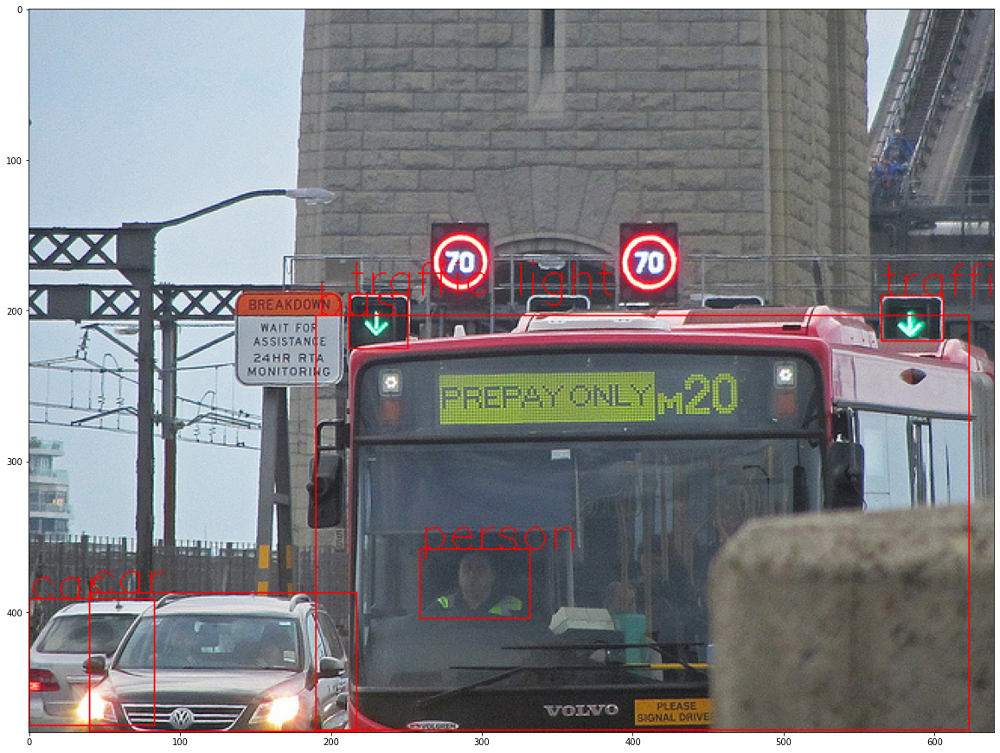

adv example generated!
processing image 430871
tensor([14, 10])
[[(40.802868, 45.202457), (185.1304, 392.0406)]]
['parking meter']


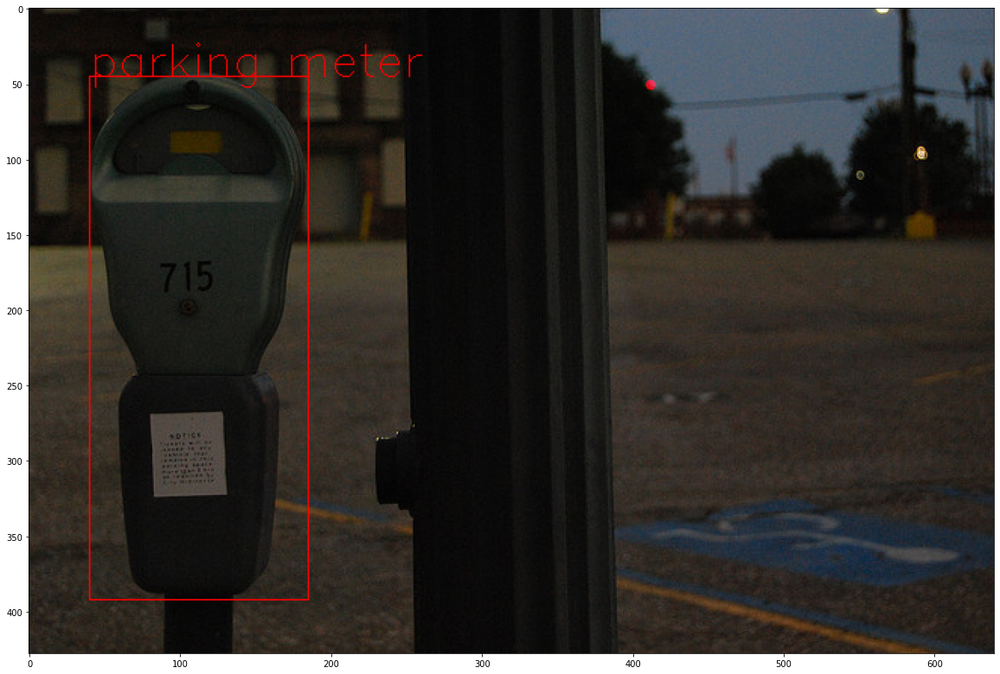

adv example generated!
processing image 354753
tensor([10, 10, 10,  3,  3,  3,  3,  3, 10])
[[(188.5442, 210.48686), (218.33556, 226.74974)], [(488.87054, 132.8378), (501.80283, 146.32224)], [(308.15933, 139.96393), (326.91006, 163.4338)], [(364.25977, 135.13956), (388.87683, 167.29402)], [(421.44342, 133.52199), (442.15027, 153.5143)], [(310.96902, 142.2012), (323.51715, 155.71841)], [(242.99953, 230.72014), (309.17664, 272.4062)]]
['car', 'traffic light', 'traffic light', 'traffic light', 'traffic light', 'traffic light', 'car']


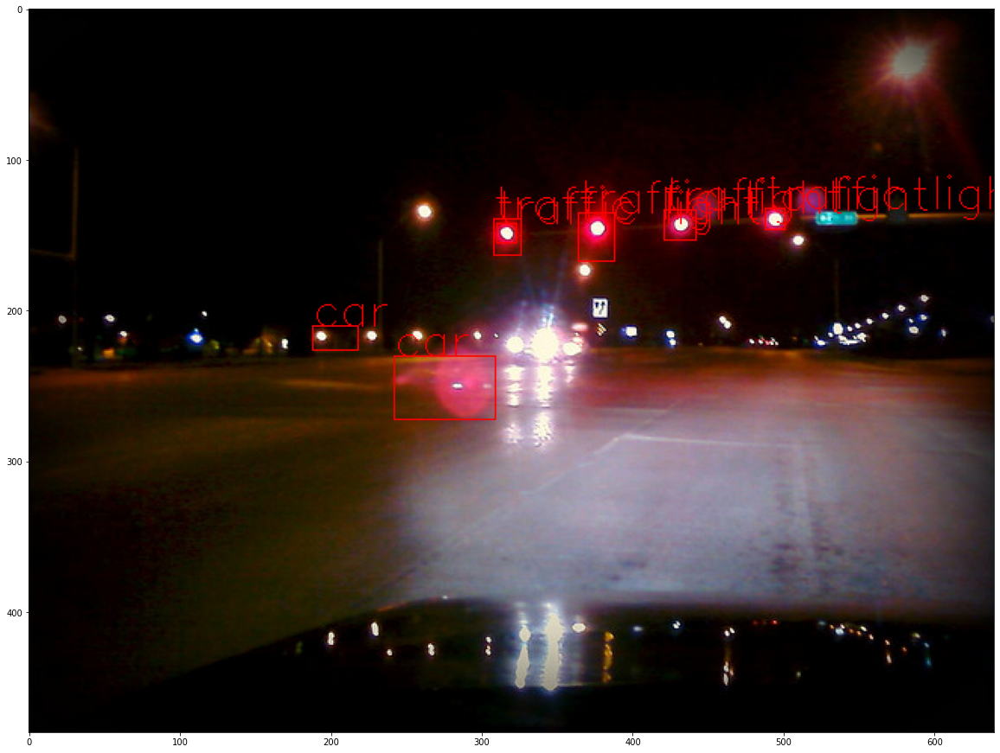

adv example generated!
processing image 500826
tensor([10])
[[(175.29454, 384.789), (214.68304, 424.73254)]]
['traffic light']


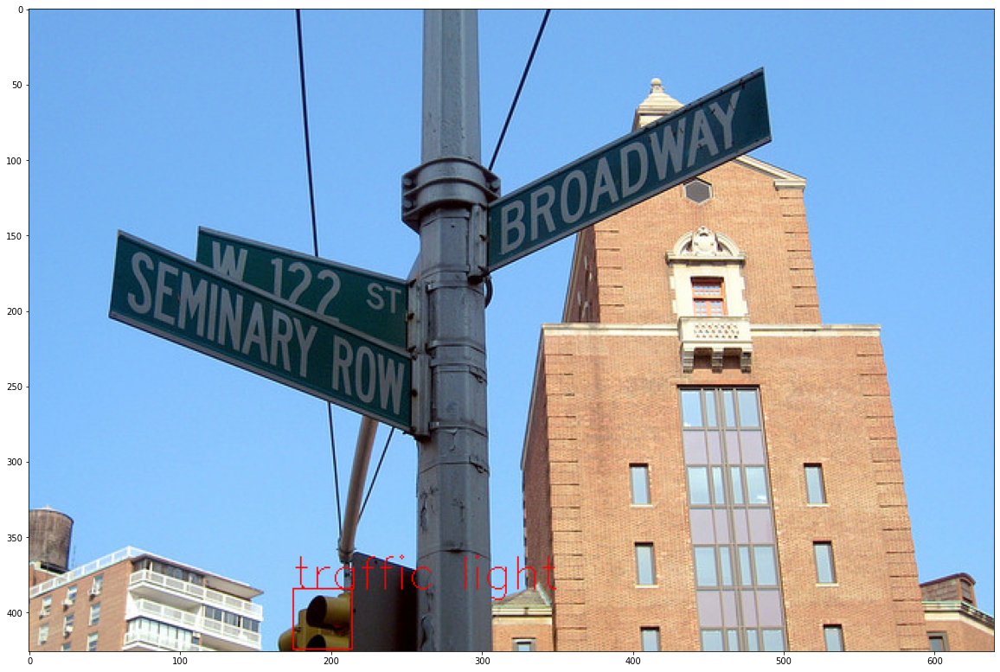

adv example generated!
processing image 492077
tensor([ 3,  3,  3,  6,  2,  2, 10, 10,  1,  1,  1,  1,  1,  2,  3, 10,  1,  1,
         1,  1,  1,  1,  2, 10, 10, 10])
[[(3.2475924, 99.81126), (193.12648, 480.00003)], [(171.36156, 157.0956), (275.53168, 440.5661)], [(486.21002, 170.56708), (511.37302, 223.32408)], [(249.71211, 161.68832), (313.32382, 301.622)], [(325.07013, 177.40746), (343.68213, 198.74712)], [(297.02008, 171.00592), (330.8724, 293.55692)], [(357.48532, 178.88017), (368.62823, 187.57486)], [(439.55637, 79.92017), (459.07822, 116.224846)], [(408.98215, 123.94094), (416.38782, 137.8559)], [(345.50095, 179.8823), (357.1152, 187.98636)], [(189.60556, 295.9978), (272.4407, 462.78632)], [(504.49637, 170.58676), (514.4614, 194.50523)], [(0.0, 11.878153), (187.3455, 229.02303)], [(225.90648, 133.43431), (234.70547, 148.4179)], [(465.25305, 172.3304), (471.6755, 191.83109)], [(274.56335, 0.016577912), (308.3094, 33.898624)], [(466.51636, 149.37439), (471.32617, 156.6923)], [(2

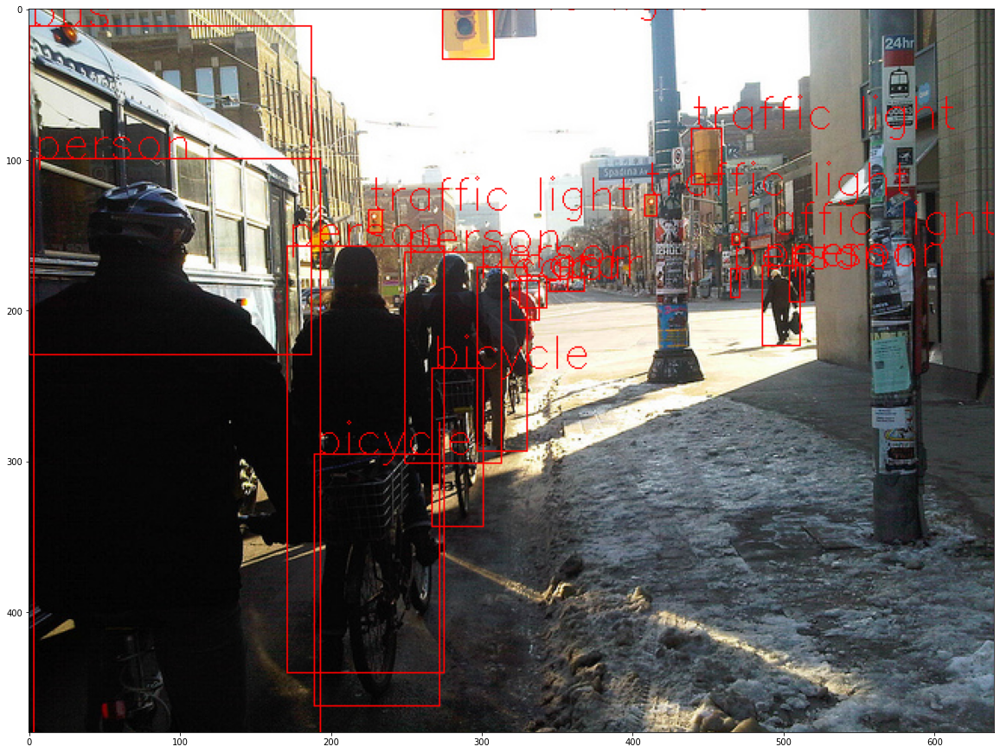

adv example generated!
processing image 436738
tensor([ 3,  3,  6,  8, 10, 10,  1,  1, 84,  3])
[[(156.35457, 295.49448), (390.45, 396.47037)], [(61.659203, 340.8259), (91.67643, 406.46906)], [(131.38902, 334.17844), (151.27779, 397.50296)], [(449.2384, 346.97385), (496.61182, 380.98767)], [(122.99298, 284.94083), (134.47067, 311.80768)], [(103.60608, 285.15927), (112.3192, 311.1757)], [(260.04016, 348.77887), (398.7096, 403.85574)], [(384.20032, 347.57495), (465.52274, 390.28647)], [(469.8494, 347.2731), (499.99997, 379.0708)], [(384.54813, 304.83206), (450.06503, 357.0117)], [(200.77847, 324.76416), (214.58733, 342.48502)]]
['bus', 'person', 'person', 'car', 'traffic light', 'traffic light', 'car', 'car', 'car', 'bus', 'person']


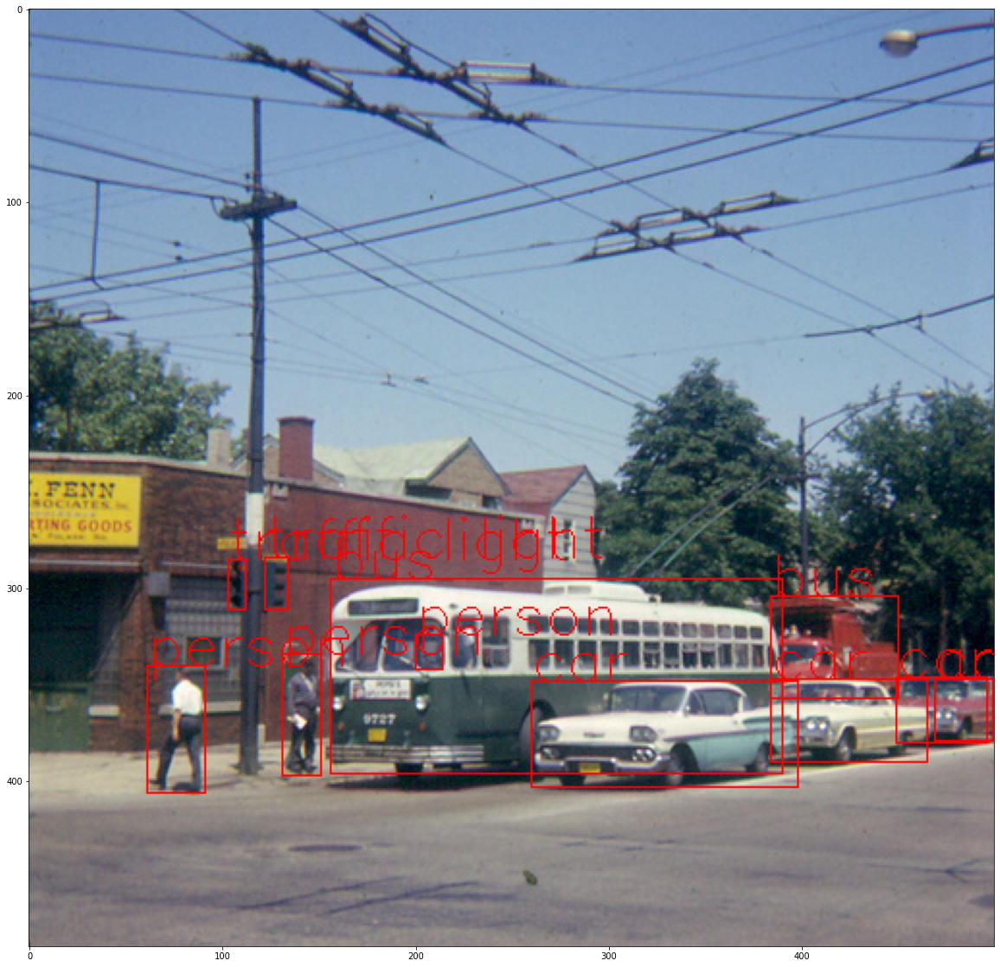

adv example generated!
processing image 174482
tensor([ 2,  3,  3, 10, 10,  3,  3,  3,  8,  8,  8, 10])
[[(201.21806, 24.102041), (493.43326, 388.0)], [(395.31305, 80.78353), (480.97552, 115.652596)], [(149.25705, 72.799644), (236.34694, 113.87171)], [(366.1281, 87.19709), (398.62817, 109.738884)], [(474.3148, 78.51568), (515.29254, 119.77812)], [(71.32042, 75.50458), (87.34802, 95.36375)], [(86.44509, 81.63127), (109.26516, 95.214905)], [(95.692184, 68.103584), (100.46595, 73.37126)], [(108.968056, 25.896666), (116.60916, 37.681477)], [(190.3567, 42.575325), (195.36514, 49.176598)], [(122.44215, 79.49003), (131.71225, 93.650505)], [(500.2474, 22.554129), (640.0, 138.71301)]]
['bicycle', 'car', 'car', 'car', 'car', 'car', 'car', 'traffic light', 'traffic light', 'traffic light', 'car', 'car']


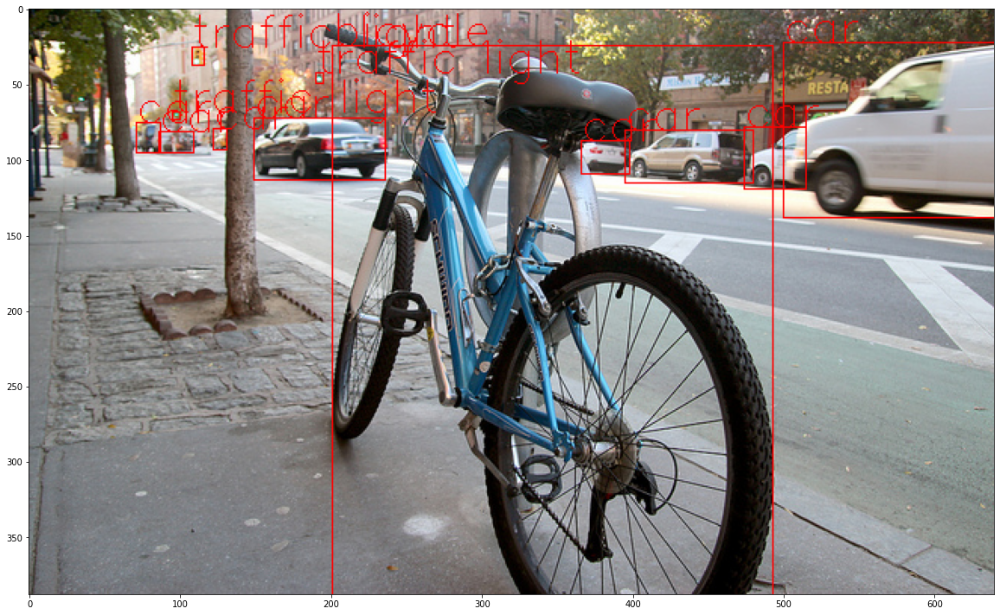

adv example generated!
processing image 71877
tensor([ 1, 41, 10])
[[(188.9845, 222.76144), (354.50314, 330.50986)], [(83.788315, 51.88257), (348.06406, 321.65402)]]
['skateboard', 'person']


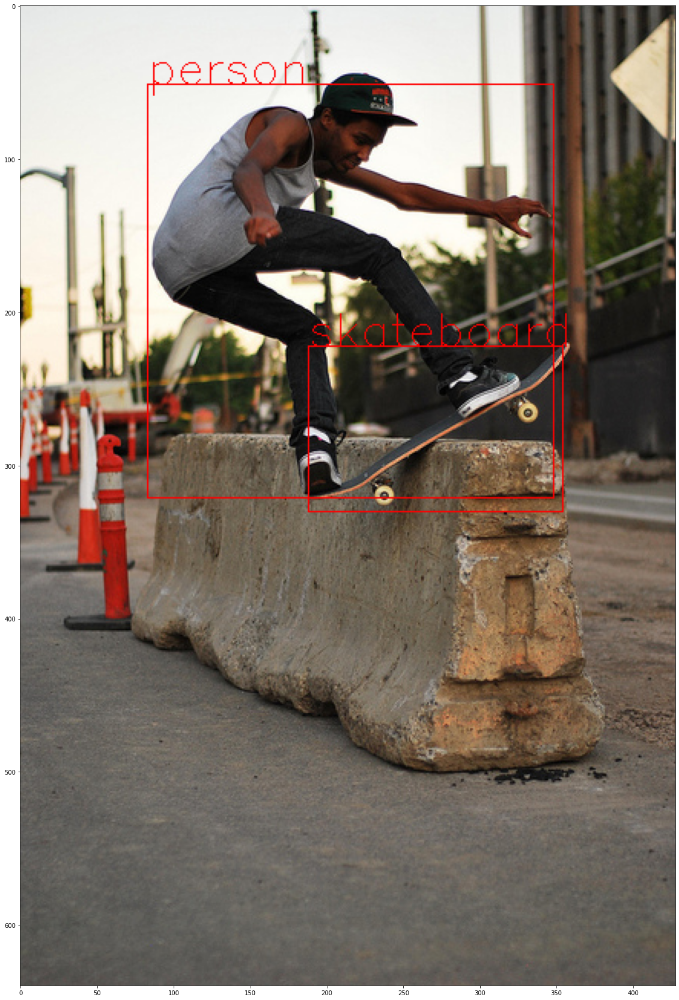

adv example generated!
processing image 335800
tensor([10])
[[(339.70453, 212.40305), (463.33658, 418.5509)]]
['kite']


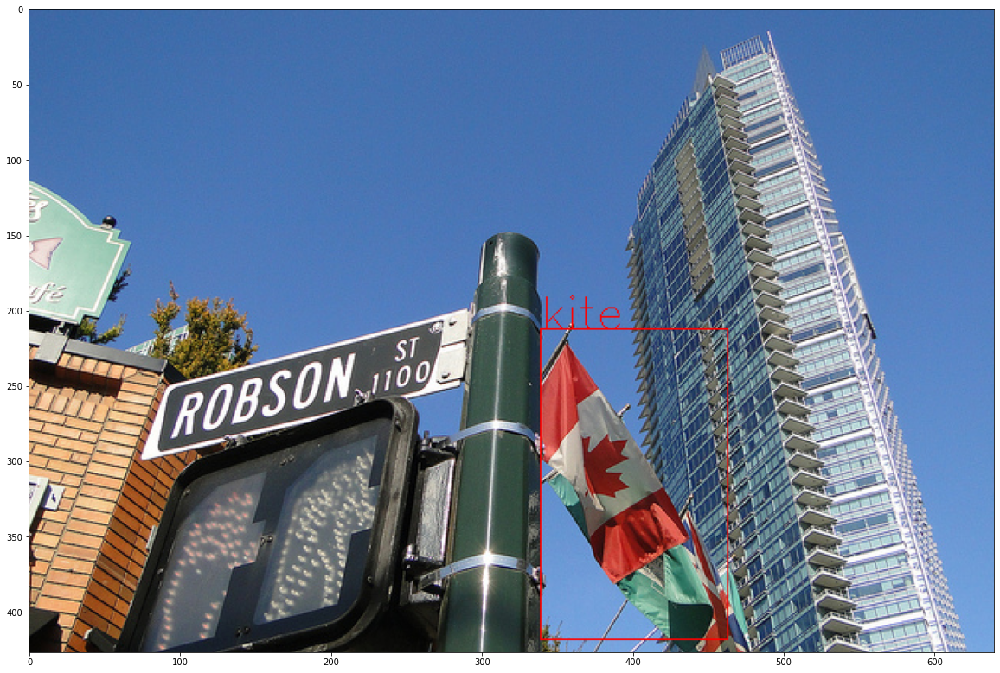

adv example generated!
processing image 269682
tensor([10, 10, 10, 10, 10, 10, 10, 10, 10, 10])
[[(300.90125, 330.66058), (315.22226, 370.08444)], [(328.35257, 408.683), (337.1191, 429.67267)], [(553.2337, 409.8596), (561.4116, 430.28098)], [(618.58295, 403.99332), (627.3504, 424.42355)], [(421.2355, 316.86417), (436.31897, 356.94873)], [(346.24744, 415.3782), (354.65915, 435.3504)], [(546.4872, 290.1585), (571.60126, 344.35858)], [(201.79752, 435.80576), (211.08226, 468.01437)], [(255.9826, 336.2798), (281.01477, 368.47845)]]
['traffic light', 'traffic light', 'traffic light', 'traffic light', 'traffic light', 'traffic light', 'traffic light', 'traffic light', 'traffic light']


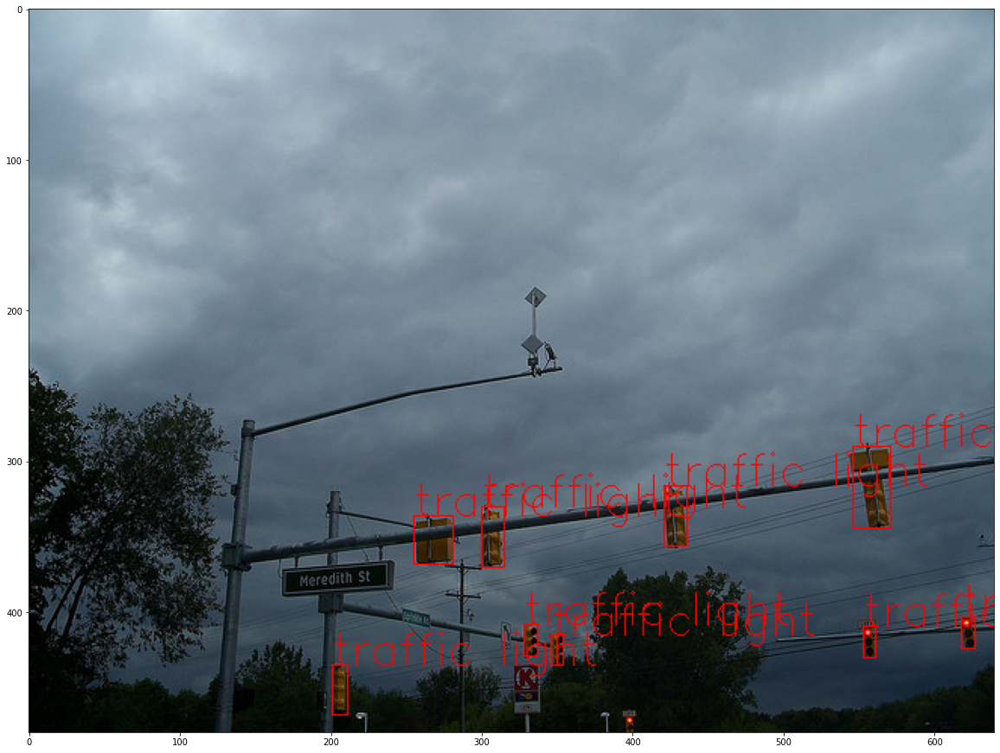

adv example generated!
processing image 544605
tensor([10])
[[(286.2056, 309.40228), (321.9075, 347.94388)]]
['traffic light']


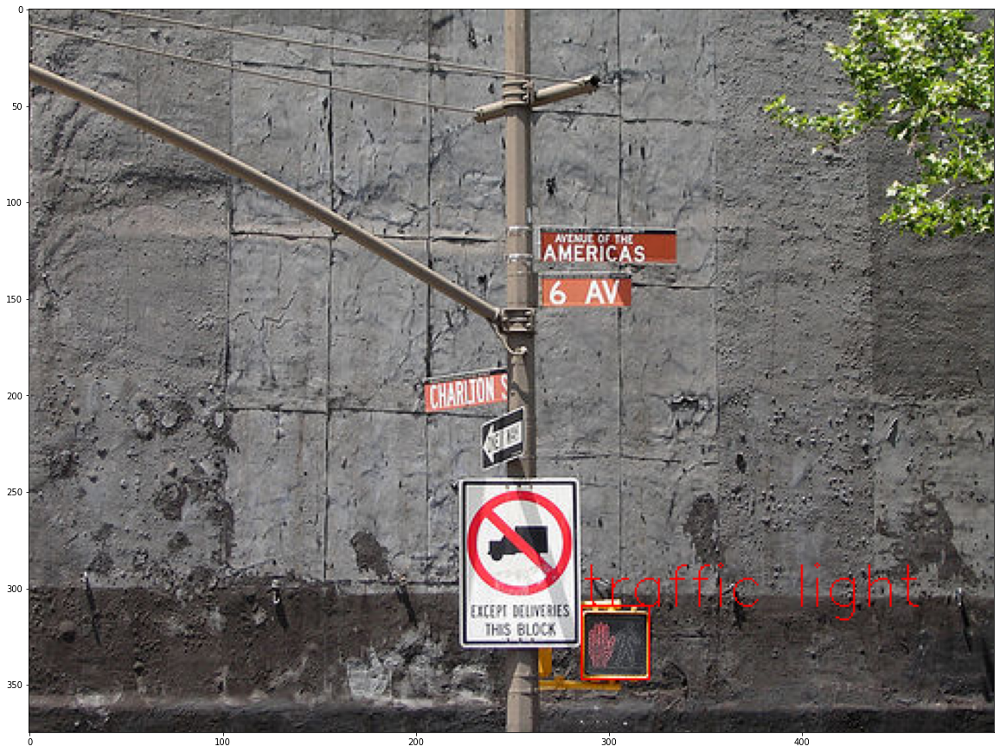

adv example generated!
processing image 28993
tensor([11, 11, 10, 10, 10,  1,  1,  1,  1,  1,  1,  1,  1,  1, 11])
[[(31.188236, 237.26936), (43.3263, 276.83463)], [(175.50424, 172.47511), (463.16672, 580.7737)], [(64.582245, 243.16673), (74.49036, 273.09283)], [(146.63895, 244.29776), (156.64241, 272.2974)], [(135.70787, 245.12595), (145.44406, 271.85486)], [(51.759506, 235.14893), (63.859673, 271.23532)], [(249.7697, 267.7087), (340.31122, 536.2233)]]
['person', 'fire hydrant', 'person', 'person', 'person', 'person', 'vase']


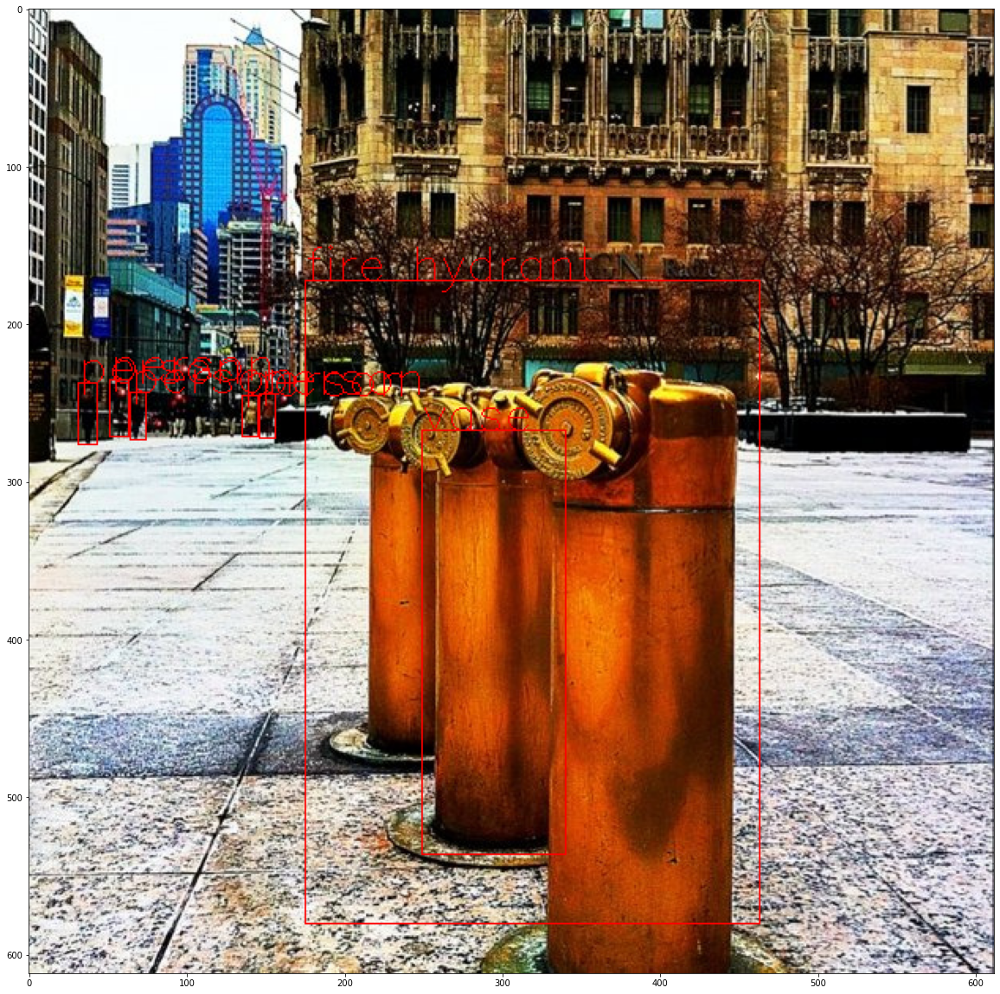

adv example generated!
processing image 284445
tensor([ 6, 10, 10, 10,  1, 10, 10, 27,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
         6, 10,  1,  3,  1,  1])
[[(167.01602, 309.60226), (300.38025, 584.8414)], [(463.9359, 320.0726), (527.5479, 518.9146)], [(122.46043, 338.29468), (143.38531, 388.96768)], [(280.89398, 327.67828), (357.3194, 529.2284)], [(347.4395, 315.28766), (418.58752, 532.34216)], [(223.34856, 157.88185), (299.79953, 268.99197)], [(534.52576, 327.94394), (597.02985, 513.39056)], [(599.0536, 324.1579), (639.60693, 571.1659)], [(428.20676, 274.91092), (442.24774, 300.0005)], [(152.0424, 277.84454), (165.08398, 310.08603)], [(515.3609, 316.28537), (558.4123, 453.55167)], [(436.34036, 330.04462), (469.1284, 417.73438)], [(585.3237, 323.3532), (623.7142, 454.98184)], [(388.25894, 319.4134), (429.12103, 403.3025)], [(173.0687, 288.66998), (181.45192, 307.28076)], [(181.88426, 338.21106), (197.00665, 375.4815)], [(3.6082964, 320.98578), (32.977318, 350.64832)], [(478.75085,

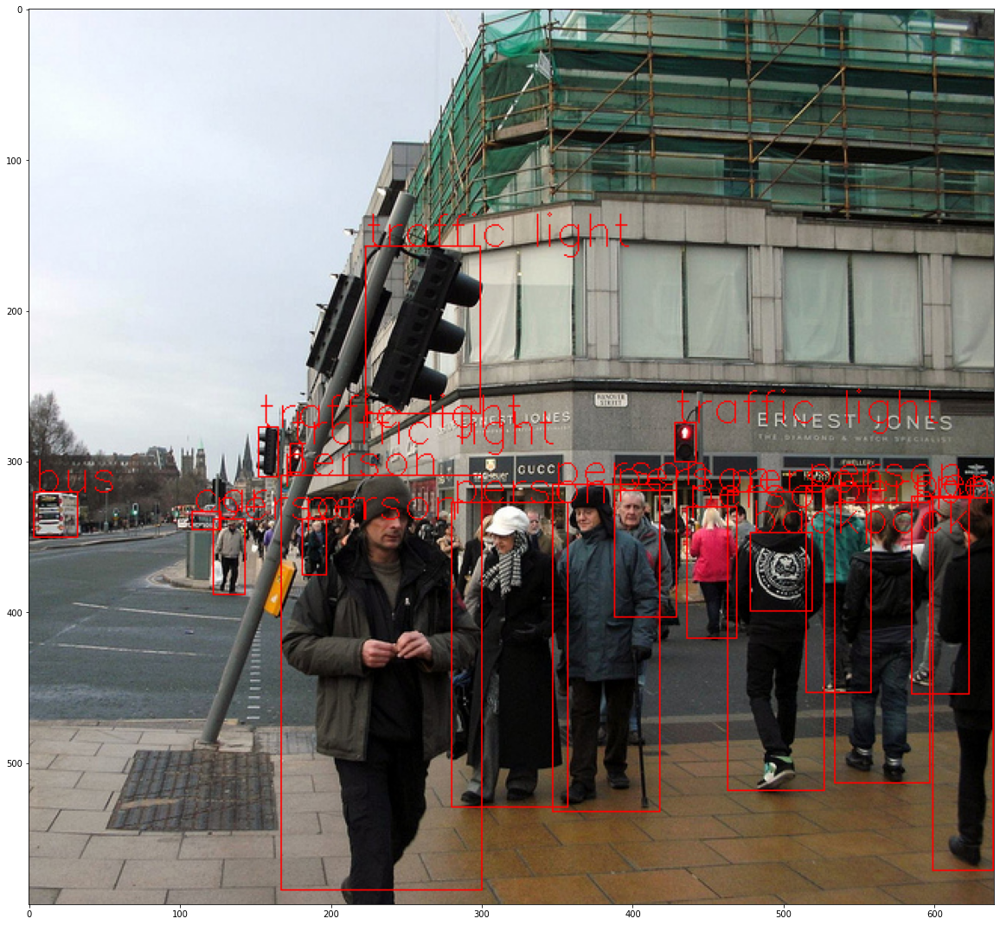

adv example generated!
processing image 532530
tensor([ 1,  1,  1, 10,  1, 18])
[[(514.77423, 384.94592), (525.8721, 414.2239)], [(463.1151, 383.27087), (475.0292, 413.3678)], [(450.3363, 396.73944), (456.86252, 414.2009)], [(389.67062, 367.1227), (407.21237, 376.08832)], [(350.8258, 357.8822), (365.42566, 388.59927)]]
['person', 'person', 'person', 'car', 'car']


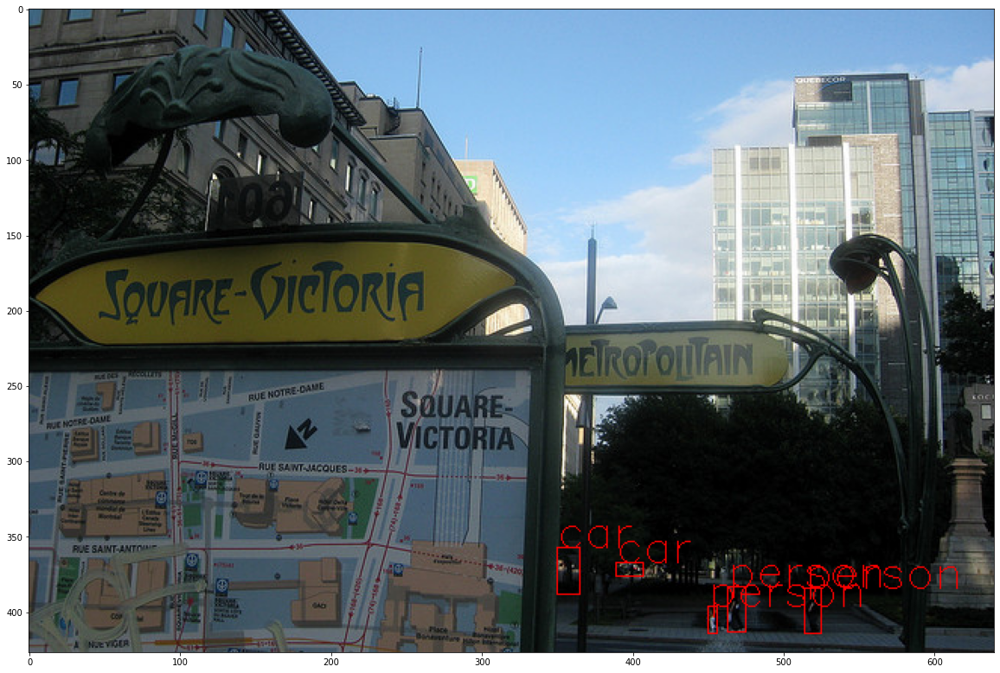

adv example generated!
processing image 338560
tensor([ 3,  3,  3,  3,  3, 10, 10, 10, 10, 11, 10, 10])
[[(135.50938, 151.59639), (316.02847, 612.33655)], [(0.0, 166.13911), (60.93247, 205.67656)], [(58.004787, 164.27432), (136.98172, 200.80765)], [(406.74402, 154.00488), (466.6273, 182.20914)], [(264.62326, 120.725136), (274.384, 141.38852)], [(35.34265, 165.10544), (81.54554, 181.07896)], [(155.35359, 103.002335), (171.93471, 111.991745)], [(113.85024, 160.47816), (177.6091, 196.45425)]]
['fire hydrant', 'car', 'car', 'car', 'traffic light', 'car', 'traffic light', 'car']


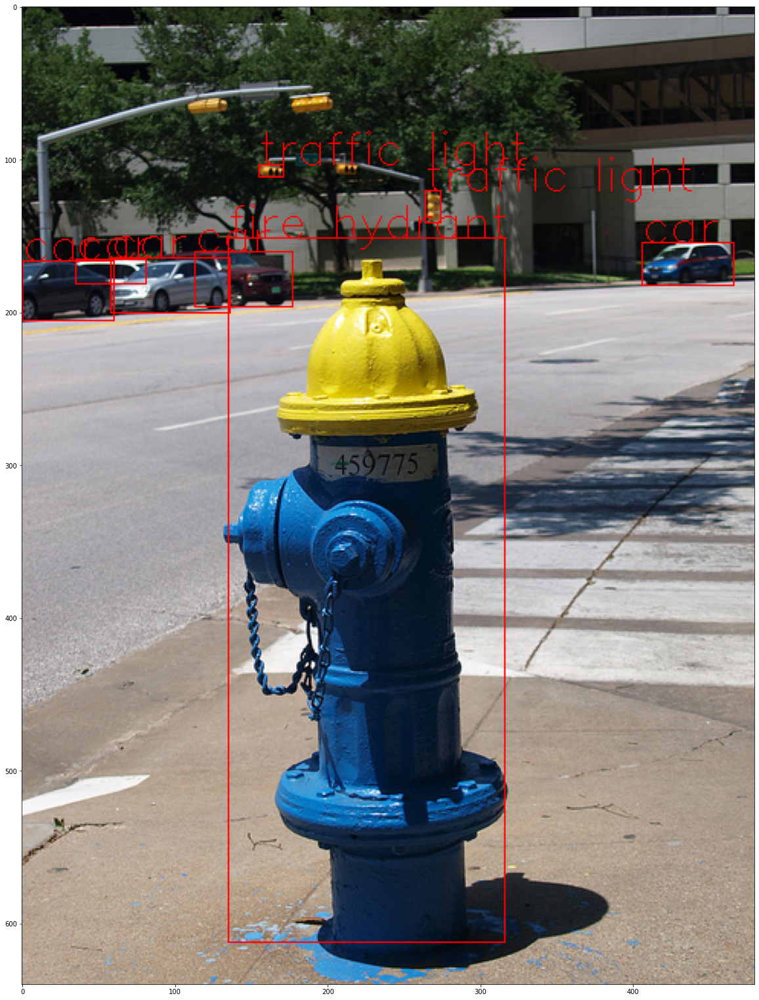

adv example generated!
processing image 499181
tensor([ 3, 10, 10, 10,  1,  3,  3,  3,  3,  3, 10, 10, 13])
[[(0.3708693, 273.66498), (72.20741, 316.01733)], [(22.800234, 394.24304), (190.97015, 474.11343)], [(493.59143, 237.34193), (584.67267, 278.61154)], [(108.079414, 149.98209), (134.60558, 242.2152)], [(275.30002, 282.49704), (290.21194, 320.89154)], [(252.15437, 281.12546), (268.79437, 315.2179)], [(238.95163, 282.11063), (266.6872, 315.58813)], [(540.4617, 192.68704), (620.75525, 234.5871)], [(620.6174, 199.42157), (639.76416, 240.74683)], [(249.74821, 321.88165), (269.76776, 358.6406)], [(108.63395, 408.50305), (130.05345, 427.95596)], [(237.63892, 284.17245), (254.86266, 314.04718)], [(201.58612, 320.68314), (213.19762, 365.26404)], [(223.163, 319.02448), (245.5406, 335.9315)], [(264.8837, 278.81677), (286.67825, 317.9218)]]
['car', 'car', 'car', 'traffic light', 'traffic light', 'traffic light', 'traffic light', 'car', 'car', 'stop sign', 'person', 'traffic light', 'traffic l

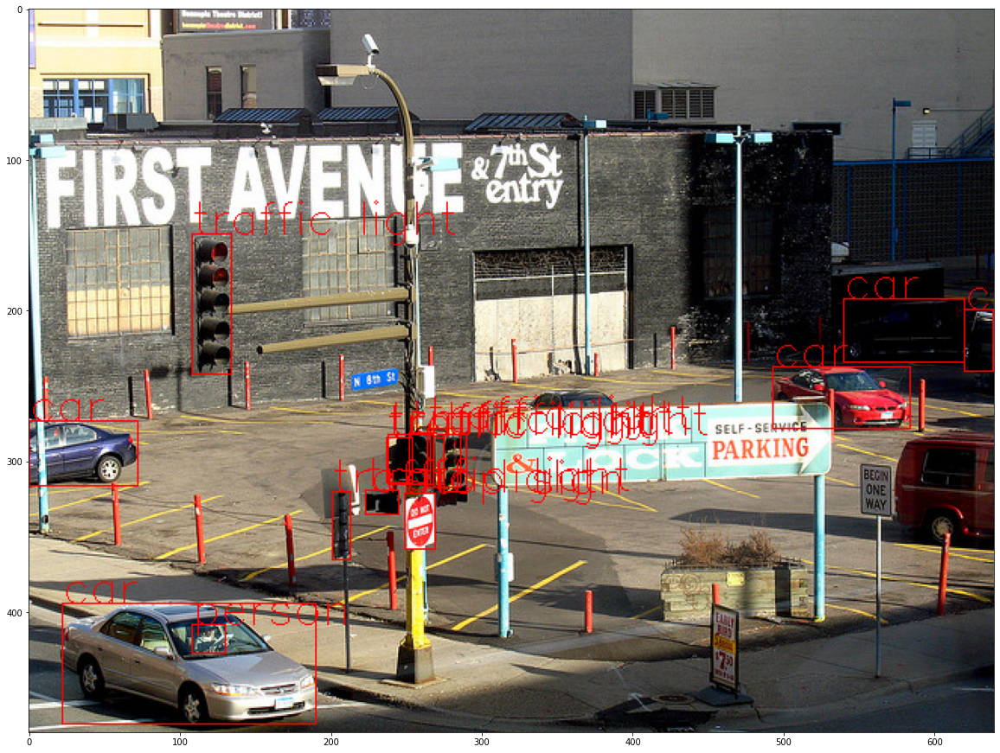

adv example generated!
processing image 315450
tensor([ 3,  6,  6, 10, 10, 10, 10, 10, 10,  3,  8,  3,  3,  6, 10, 10, 10, 10,
        10])
[[(154.53296, 110.23035), (432.73624, 303.51422)], [(421.85178, 103.18662), (637.9881, 305.74677)], [(48.041546, 229.97589), (147.77504, 300.23248)], [(6.473858, 219.18224), (57.398777, 262.98874)], [(38.92697, 141.48901), (48.659977, 164.57219)], [(135.89282, 85.772385), (149.18704, 116.257805)], [(115.713326, 136.99207), (124.47069, 155.2563)], [(76.17247, 175.29904), (82.70588, 189.88997)], [(0.09178289, 228.42877), (11.524682, 254.15657)], [(50.807858, 223.05522), (76.670784, 244.95992)], [(123.55694, 207.5671), (162.24876, 263.14932)], [(0.0, 211.8324), (9.29407, 226.7661)]]
['bus', 'bus', 'car', 'car', 'traffic light', 'traffic light', 'traffic light', 'traffic light', 'car', 'car', 'truck', 'car']


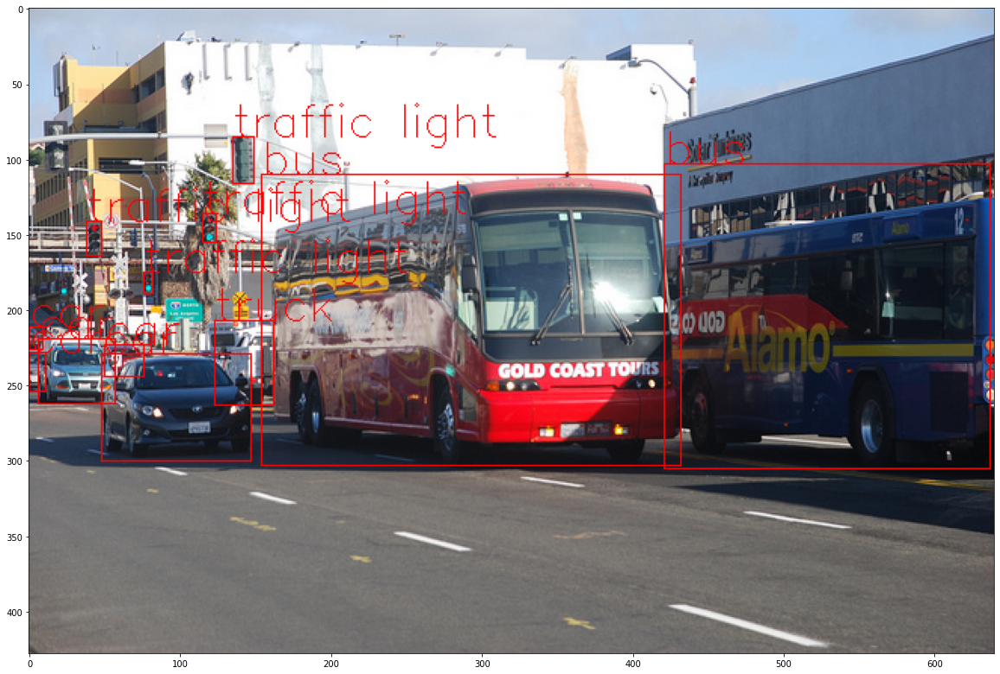

adv example generated!
processing image 396200
tensor([ 3,  3, 10, 10, 41, 41,  3, 10, 10, 10, 37,  1,  8,  1])
[[(464.08652, 153.33258), (625.84045, 323.80658)], [(306.8885, 102.093765), (390.4213, 291.61035)], [(339.79193, 282.69806), (364.3192, 300.00455)], [(473.61047, 65.92365), (486.8257, 100.03848)], [(498.06577, 192.31601), (521.68134, 217.86496)], [(388.10114, 193.45839), (416.9296, 212.5925)], [(621.1744, 179.03882), (639.70844, 254.64635)], [(458.34427, 270.57385), (498.58368, 296.40195)], [(537.30005, 318.0495), (577.05273, 339.078)], [(526.3661, 75.49845), (540.2691, 99.64783)], [(415.56412, 170.23537), (495.1942, 217.30411)], [(359.3475, 224.38762), (395.85846, 254.05968)], [(607.67, 180.2527), (637.7561, 251.3325)], [(378.7072, 193.08775), (406.12805, 212.0282)]]
['person', 'person', 'skateboard', 'traffic light', 'car', 'car', 'car', 'skateboard', 'skateboard', 'traffic light', 'truck', 'bench', 'car', 'car']


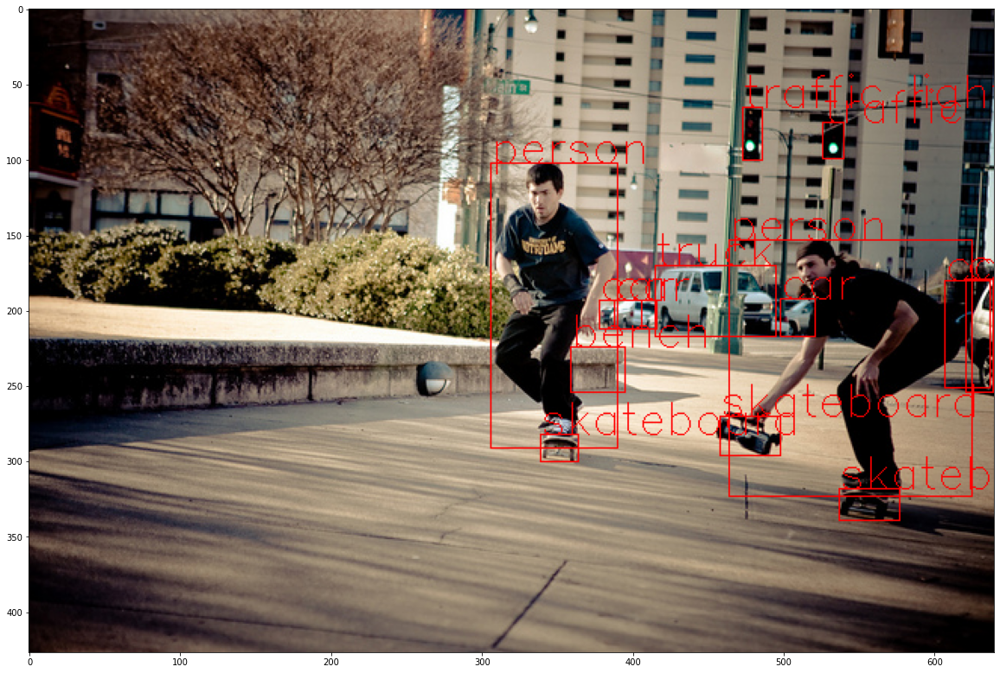

adv example generated!
processing image 178982
tensor([ 4,  4,  1,  1, 10, 10, 10, 10, 10])
[[(325.50403, 241.22182), (368.7886, 338.65598)], [(455.1964, 251.40439), (502.60382, 342.25708)], [(456.26892, 279.23712), (511.80197, 358.44797)], [(499.94394, 57.89691), (514.7498, 96.14818)], [(324.24872, 277.90775), (371.3384, 355.0803)], [(474.86783, 57.63912), (491.9956, 98.29516)], [(505.38977, 300.30533), (640.0, 379.94952)], [(475.3741, 51.82127), (503.61667, 98.97046)], [(562.165, 197.19214), (583.49243, 216.53366)], [(89.3099, 191.06775), (99.84191, 202.78731)]]
['person', 'person', 'motorcycle', 'traffic light', 'motorcycle', 'traffic light', 'car', 'traffic light', 'traffic light', 'traffic light']


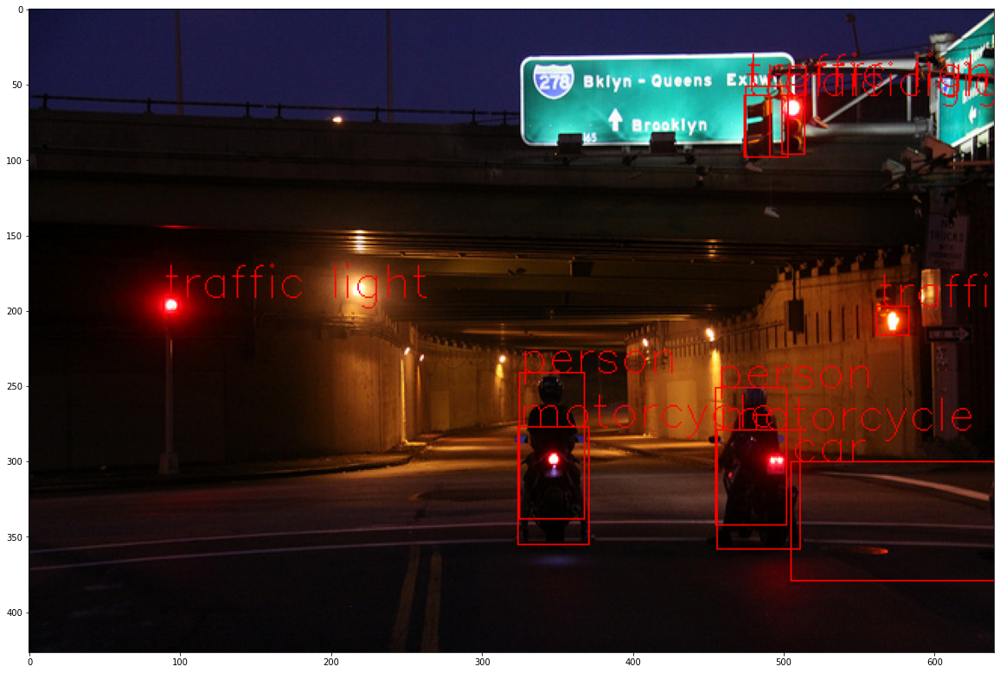

adv example generated!
processing image 184400
tensor([ 7, 10])
[[(17.28479, 216.07841), (633.02637, 443.74283)], [(5.7966037, 210.0808), (630.0667, 321.02228)]]
['train', 'train']


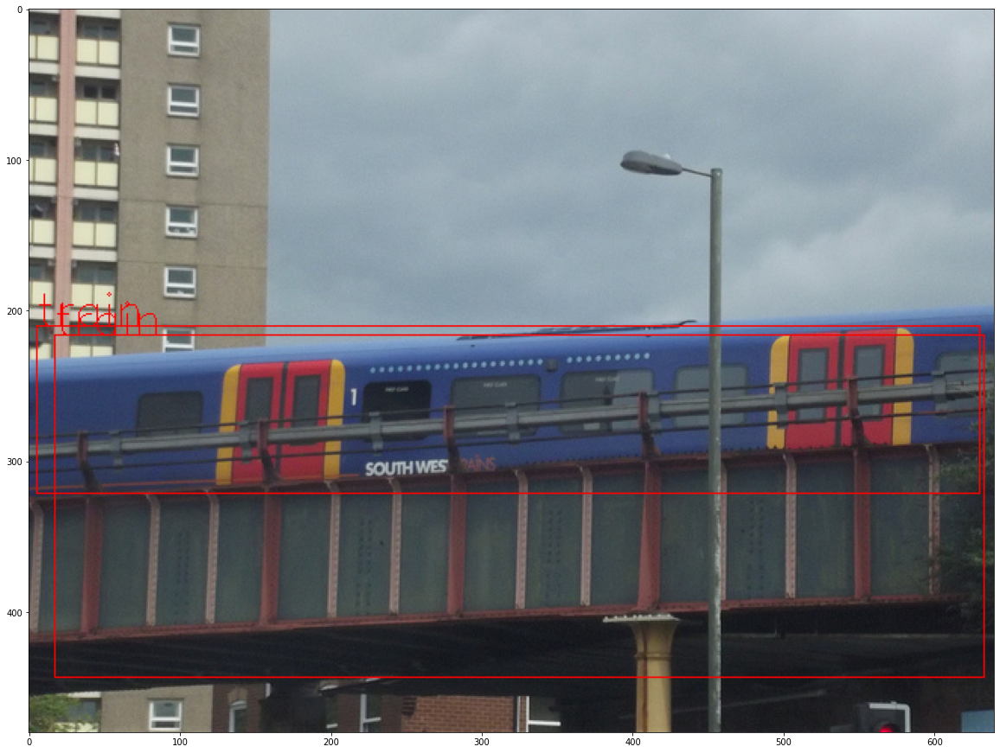

adv example generated!
processing image 295809
tensor([ 3,  3,  3,  3, 10, 10, 10,  1,  2, 10, 10, 10,  3, 10, 10,  3, 10, 10,
         1, 11])
[[(532.4711, 110.20065), (636.05176, 140.62141)], [(247.95007, 112.03363), (256.119, 139.30812)], [(82.67805, 35.173565), (93.77145, 65.75505)], [(378.67886, 22.695751), (386.85895, 42.540184)], [(520.2677, 60.31814), (528.6351, 83.158615)], [(71.82608, 37.973648), (80.76805, 66.8997)], [(231.14656, 68.95721), (240.35902, 89.93572)], [(295.78305, 117.80574), (325.8056, 137.51659)], [(432.26404, 127.92662), (437.9713, 138.76843)], [(354.43207, 126.01781), (363.44455, 132.4317)], [(504.36328, 60.17326), (515.0406, 83.41943)], [(318.29095, 119.21316), (329.82715, 134.36066)], [(49.831425, 104.23344), (149.27052, 141.3382)], [(282.14352, 116.98915), (288.28766, 132.08865)]]
['car', 'person', 'traffic light', 'traffic light', 'traffic light', 'traffic light', 'traffic light', 'car', 'fire hydrant', 'car', 'traffic light', 'car', 'car', 'person']


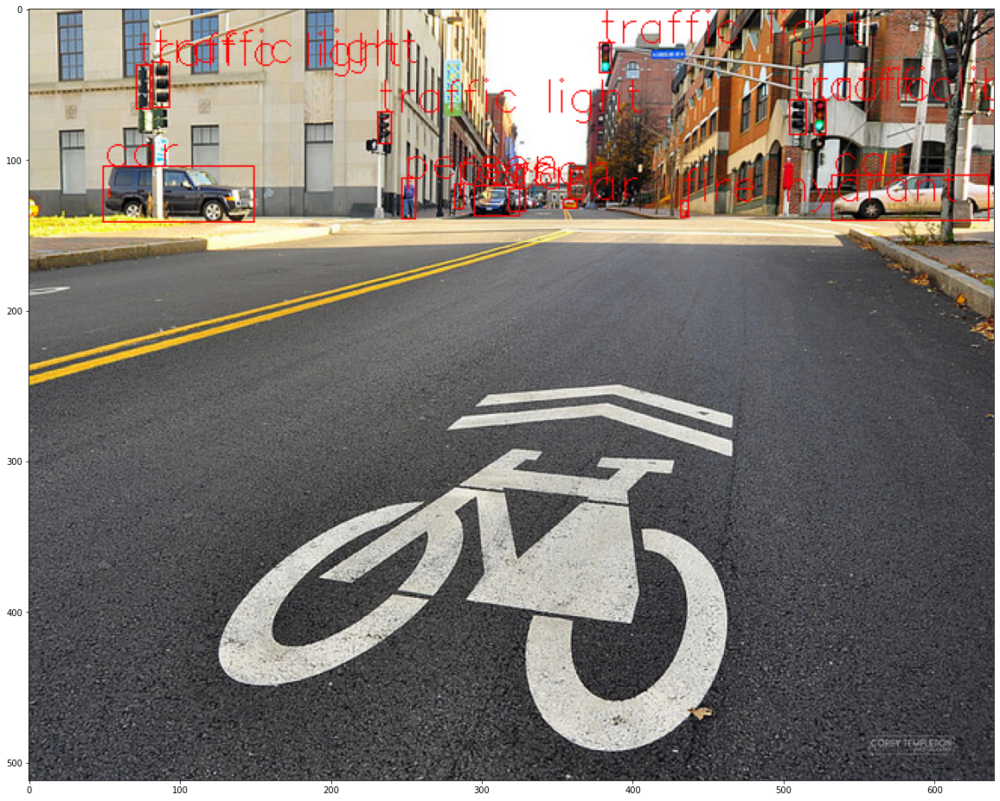

In [ ]:
COCO_INSTANCE_CATEGORY_NAMES = [
'__background__', 'person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus',
'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'N/A', 'stop sign',
'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow',
'elephant', 'bear', 'zebra', 'giraffe', 'N/A', 'backpack', 'umbrella', 'N/A',
'N/A',
'handbag', 'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball',
'kite', 'baseball bat', 'baseball glove', 'skateboard', 'surfboard', 'tennis racket',
'bottle', 'N/A', 'wine glass', 'cup', 'fork', 'knife', 'spoon', 'bowl',
'banana', 'apple', 'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog',
'pizza',
'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed', 'N/A', 'dining table',
'N/A', 'N/A', 'toilet', 'N/A', 'tv', 'laptop', 'mouse', 'remote', 'keyboard',
'cell phone',
'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'N/A', 'book',
'clock', 'vase', 'scissors', 'teddy bear', 'hair drier', 'toothbrush'
]


is_finetune = False
root = '/gdrive/My Drive/datasets/coco/val2017'
annFile = '/gdrive/My Drive/datasets/coco/annotations/instances_val2017.json'
classes = ['traffic light'] # ['person', 'bicycle', 'car', 'truck', 'bus', 'motorcycle', 'traffic light', 'stop sign']
epsilons = [0, .05, .1, .15, .2, .25, .3]


coco_val = SubCocoDetection(root=root, annFile=annFile, classes=classes, transforms=get_transform())
coco_loader = torch.utils.data.DataLoader(coco_val, batch_size=1, shuffle=True, collate_fn=collate_fn)

device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
model = get_model_faster_rcnn(is_finetune=is_finetune)
model = model.to(device)

accuracies = []
examples = []

for eps in epsilons:
    ex = test(root, model, device, coco_loader, eps, COCO_INSTANCE_CATEGORY_NAMES)
    examples.append(ex)

plot_performance_degrade(epsilons, accuracies)

In [ ]:
def model(t_u, w):
    return w[0] * t_u + w[1]

def loss_f(t_p, t_c):
    squared_diffs = (t_p - t_c)**2
    return squared_diffs.mean()

t_u = torch.tensor([0.5, 14.0, 15.0], requires_grad=True) # 1 x 3
t_c = torch.tensor([35.7, 55.9, 58.2], requires_grad=True) # 1 x 3
params = torch.tensor([2.0, 0.0], requires_grad=True)
print(t_u)
loss = loss_f(model(t_u, params), t_c)
loss.backward()
print(t_u.is_leaf, t_c.is_leaf, params.is_leaf)
print(t_u.grad)